# Plotly tutorial

In [1]:
import pandas as pd
import numpy as np
import cufflinks as cf
import chart_studio.plotly as py
import seaborn as sns
import plotly.express as px
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()

### Basics

In [2]:
arr_1 = np.random.rand(50,4)
df_1 = pd.DataFrame(arr_1, columns=['A','B','C','D'])
df_1.head()

,A,B,C,D
0,0.209666,0.995988,0.560780,0.801502
1,0.423231,0.590027,0.691960,0.719189
2,0.989418,0.755647,0.369323,0.554502
3,0.041311,0.273726,0.167763,0.917432
4,0.725611,0.487984,0.990037,0.804366


<AxesSubplot:>

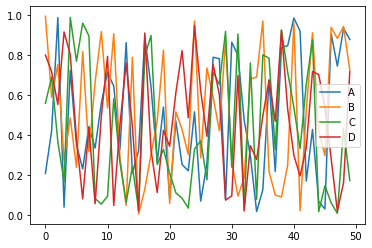

In [3]:
# old way of doing it
df_1.plot()

In [4]:
# drastically better with plotly
df_1.iplot()

### Line Plots

In [5]:
import plotly.graph_objects as go
df_stock = px.data.stocks()
px.line(df_stock, x='date', y='GOOG', labels={'x':'Date', 'y':'Price'})


In [6]:
px.line(df_stock, x='date', y=['GOOG','AAPL'],
        labels={'x':"DATE",'y':"PRICES"}, title="Apple versus Google")

Note that you can remove the lines by clicking on the ledger on the right

In [7]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_stock['date'], y=df_stock['AAPL'], mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=df_stock['date'], y=df_stock['AMZN'], mode='lines', name='Amazon'))
fig.add_trace(go.Scatter(x=df_stock['date'], y=df_stock['GOOG'], mode='lines', name='Google',
                         line=dict(color='firebrick',  width=2,dash="dashdot")))

fig.update_layout(title="Stock Price Data 2018 - 2020", xaxis_title="Price", yaxis_title="Date")


Showing it with most features turned off

In [8]:

fig.update_layout(xaxis=dict(showline=True, showgrid=False, showticklabels=True,
                            linecolor='rgb(204, 204, 204)', linewidth=2, ticks='outside',
                            tickfont=dict(family='Arial', size=12, color="rgb(82, 82, 82)")),
                  yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                 autosize=False,
                 margin = dict(
                 autoexpand = False, l=100, r=20, t=110,),
                 showlegend = False, plot_bgcolor='white')

### Bar Charts

In [9]:
df_us = px.data.gapminder().query("country == 'United States'")
px.bar(df_us, x='year', y='pop')


In [10]:
df_tips = px.data.tips()
px.bar(df_tips, x='day', y='tip', color='sex',
       title='Tips by sex on Each day', labels={'tip': 'Tip Amount', 'day': 'Day of the Week'})

In [11]:
px.bar(df_tips, x='sex', y='total_bill', color='smoker', barmode='group')

In [12]:
df_europe = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6")
df_europe.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
83,Austria,Europe,2007,79.829,8199783,36126.492700,AUT,40
119,Belgium,Europe,2007,79.441,10392226,33692.605080,BEL,56
155,Bosnia and Herzegovina,Europe,2007,74.852,4552198,7446.298803,BIH,70
191,Bulgaria,Europe,2007,73.005,7322858,10680.792820,BGR,100


In [13]:
fig = px.bar(df_europe, y='pop', x='country', text='pop', color='country')
fig

In [14]:
fig.update_traces(texttemplate="%{text:.2s}", textposition='outside')
fig.update_layout(uniformtext_minsize=8, xaxis_tickangle=-45)


### Scatter Plots

In [15]:
df_iris = px.data.iris()
px.scatter(df_iris, x='sepal_width', y='sepal_length', color='species', size='petal_length', hover_data=['petal_width'])

In [16]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_iris['sepal_width'], y=df_iris['sepal_length'],
                        mode='markers', marker_color=df_iris['sepal_width'],
                        text=df_iris['species'], marker=dict(showscale=True)))
fig.update_traces(marker_line_width=2, marker_size=10)

In [17]:
fig = go.Figure(
    data=go.Scattergl(
        x=np.random.randn(100000),
        y=np.random.randn(100000),
        mode = 'markers',
        marker=dict(
        color=np.random.randn(100000),
        colorscale='Viridis',
        line_width=1)))
fig

### Pie Charts

In [18]:
# showing that you can stack queries, but if its in one place best to put it in one query
df_asia = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
df_asia.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
95,Bahrain,Asia,2007,75.635,708573,29796.048340,BHR,48
107,Bangladesh,Asia,2007,64.062,150448339,1391.253792,BGD,50
227,Cambodia,Asia,2007,59.723,14131858,1713.778686,KHM,116
299,China,Asia,2007,72.961,1318683096,4959.114854,CHN,156


In [19]:
px.pie(df_asia, values="pop", names='country',
       title="Population of Countries in Asia",
       #https://plotly.com/python/builtin-colorscales/
       color_discrete_sequence=px.colors.sequential.RdBu)

In [20]:
colors = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = go.Figure(data=[go.Pie(labels=['Water', 'Grass', 'Normal', 'Psychic', 'Fire', 'Ground'], values=[110,90,80,80,70,60])])
fig.update_traces(hoverinfo='label+percent', textfont_size=20, textinfo='label+percent', pull=[0.1, 0, 0.2, 0, 0, 0],
                 marker=dict(colors=colors, line=dict(color="#FFFFFF", width=2)))
fig.show()

### Histograms

In [21]:
# rolling two dice
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 + dice_2

fig = px.histogram(dice_sum, nbins=11, labels={'value': "Dice Role"},
                  title = "5000 Dice Roll Histogram", marginal='violin',
                  color_discrete_sequence=['blue'])

fig

In [22]:
fig.update_layout(
    xaxis_title_text = "Dice Roll",
    yaxis_title_text = "Dice Sum",
    bargap=0.2, showlegend=False
)

In [23]:
# stack with diff color
df_tips = px.data.tips()
px.histogram(df_tips, x="total_bill", color="sex")

### Box Plots

In [24]:
# continue using df_tips
px.box(df_tips, x='sex', y='tip', points='all')

In [25]:
px.box(df_tips, x='day', y='tip', color = 'sex')

In [26]:
fig = go.Figure()
fig.add_trace(go.Box(
    x=df_tips['sex'],
    y=df_tips['tip'],
    marker_color='blue',
    boxmean='sd'
))

In [27]:
df_stocks = px.data.stocks()
fig = go.Figure()

fig.add_trace(go.Box(
    y=df_stocks['GOOG'], boxpoints='all', name="Google",
    fillcolor="blue", jitter=0.5, whiskerwidth=0.2
))


In [28]:
fig.add_trace(go.Box(
    y=df_stocks['AAPL'], boxpoints='all', name="Apple",
    fillcolor="red", jitter=0.5, whiskerwidth=0.2
))


In [29]:
fig.update_layout(title="Google vs Apple",
                  yaxis=dict(gridcolor="rgb(255, 255, 255)",
                           gridwidth=3),
                  paper_bgcolor="rgb(243, 243, 243)",
                  plot_bgcolor="rgb(243, 243, 243)"
                 )

### Violin Polt

In [30]:
px.violin(df_tips, y='total_bill', box=True, points='all')

In [31]:
px.violin(df_tips, y='tip', x='smoker', color="sex", box=True, points='all',
         hover_data=df_tips.columns)

In [32]:
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker'] == 'Yes'],
                       y=df_tips['total_bill'][df_tips['smoker'] == 'Yes'],
                       legendgroup='Yes', scalegroup='Yes', name='Yes',
                       side='negative', line_color='blue'))
fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker'] == 'No'],
                       y=df_tips['total_bill'][df_tips['smoker'] == 'No'],
                       legendgroup='Yes', scalegroup='Yes', name='No',
                       side='positive', line_color='red'))
#fig.update_layout()

### Density Heatmaps

In [33]:
flights = sns.load_dataset('flights')
flights.head()

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121


In [34]:
fig = px.density_heatmap(flights, x='year', y='month',
                        z='passengers',
                        color_continuous_scale='Viridis')
fig

In [35]:
fig = px.density_heatmap(flights, x='year', y='month',
                        z='passengers',
                        marginal_x='histogram', marginal_y='histogram')
fig

### 3D Scatter Plot

In [36]:
fig = px.scatter_3d(flights, x='year', y='month', z='passengers',
                   color='year', opacity=0.7)
fig

### 3D Line Plot

In [37]:
fig = px.line_3d(flights, x='year', y='month', z='passengers',
                   color='year')
fig

### Scatter Matrix

In [38]:
fig = px.scatter_matrix(flights, color='month')
fig

### Map Scatter Plots

In [39]:
df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations='iso_alpha', color='continent',
                     hover_name="country",size='pop', projection='orthographic')
fig

### Choropleth Graph

In [40]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
    
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv',
                dtype={'fips' : str})
df.head()

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5


In [41]:
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                   color_continuous_scale="Viridis", range_color=(0,12),
                   scope="usa", labels={'unemp':'Unemployment rate'})
fig

### Polar Charts

In [42]:
df_wind = px.data.wind()
px.scatter_polar(df_wind, r='frequency', theta='direction',
                color='strength', size='frequency', symbol='strength')

In [43]:
px.line_polar(df_wind, r='frequency', theta='direction',
                color='strength', line_close=True, template='plotly_dark')

### Termanry Plots

compare 3 different variables in a plot

In [44]:
df_exp = px.data.experiment()
px.scatter_ternary(df_exp, a='experiment_1', b='experiment_2', c='experiment_3', hover_name='group', color='gender')


### Facet Plots

Create numerous different subplots

In [45]:
px.scatter(df_tips, x='total_bill', y='tip', color='smoker',
          facet_col='sex')

In [46]:
px.histogram(df_tips, x='total_bill', y='tip', color='sex', facet_row='time', facet_col='day',
            category_orders={'day':['Thurs', 'Fri', 'Sat', 'Sun'], 'time':['Lunch', 'Dinner']})

In [47]:
df_att = sns.load_dataset('attention')
fig = px.line(df_att, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')
fig

### Animated Plots

In [48]:
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x='gdpPercap', y='lifeExp', animation_frame='year', animation_group='country',
           size='pop', color='continent', hover_name='country', log_x=True, size_max=55, range_x=[100, 100000],
          range_y=[25, 100])

In [49]:
px.bar(df_cnt, x='continent', y='pop', color='continent',
       animation_frame='year', animation_group='country', range_y=[0,4000000000])